### Installing the libraries

In [2]:
%pip install dill
%pip install path
%pip install route 

Note: you may need to restart the kernel to use updated packages.

Note: you may need to restart the kernel to use updated packages.


### Importing the libraries

In [3]:
#Setting up paths

#Import dill library to save variables generated
import platform
import sys
import dill
import pickle
import path
import os

if platform.system() == "Windows":
    sys.path.append(rf'D:\Tensor Based ML for Neuro Imaging\INSPIRE_CAHBHIR\Python Scripts\LSR-Tensor-Ridge-Regression\Closed_Form_Solver\Code Files')
    sys.path.append(rf'D:\Tensor Based ML for Neuro Imaging\INSPIRE_CAHBHIR\Python Scripts\LSR-Tensor-Ridge-Regression\Closed_Form_Solver\Experimental Results\Tensor_Method\Closed Form')
elif platform.system() == "Darwin":
    sys.path.append()
    sys.path.append()
    
#Import Standard Data Analysis Libraries
import datetime
import numpy as np
import pandas as pd
import re
import scipy.io

#plotting functions
import matplotlib.pyplot as plt
import seaborn as sns



### Loading Data

In [19]:
#loading file path
if platform.system() == "Windows":
    pkl_file = rf"D:\Tensor Based ML for Neuro Imaging\INSPIRE_CAHBHIR\Python Scripts\LSR-Tensor-Ridge-Regression_All_Data\Closed_Form_Solver\Tucker_Regression\HCP_lambdas_[1, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]_sep_1_tucker_[50 50].pkl"
elif platform.system() == "Darwin":
    pkl_file = f"/content/gdrive/MyDrive/The Pipeline/Experimental Results/16-16-4-4/Tensor Results/ExecutionTime_2024-03-11 21:17:28, n_train_300, n_test_100, p1_16, p2_16, d1_4, d2_4, S_1 _Dataset.pkl"

file= open(pkl_file, 'rb')
data = pickle.load(file)
file.close()

# (X_train 0,Y_train 1,X_test 2,Y_test 3, 
# lambda1 4, validation_normalized_estimation_error 5, validation_nmse_losses 6, 
# validation_correlations 7, validation_R2_scores 8, objective_function_information 9,
# gradient_information 10,test_normalized_estimation_error 11, test_nmse_loss 12, test_R2_loss 13, 
# test_correlation 14, objective_function_values 15, gradient_values 16, iterate_level_values 17,
# iterate_level_reconstructed_tensor), file)
X_train = data[0]
Y_train = data[1]
X_test  = data[2]
Y_test  = data[3]
lambda1 = data[4]
validation_normalized_estimation_error = data[5]
validation_nmse_losses = data[6]
validation_correlations = data[7]
validation_R2_scores = data[8]
objective_function_information = data[9]
gradient_information = data[10]
test_normalized_estimation_error = data[11]
test_nmse_loss = data[12]
test_R2_loss = data[13]
test_correlation = data[14]
objective_function_values = data[15]
gradient_values = data[16]
iterate_level_values = data[17]

In [20]:
print(f'Selected Lamdba:',lambda1)
print(f'testing NMSE:',test_nmse_loss)
print(f'Testing Correlation',test_correlation)
print(f'Testing R2:',test_R2_loss)
print(f'Final Objective Function Values',objective_function_values[-1])
print(f'Final Gradient Values',gradient_values[-1])

Selected Lamdba: 15
testing NMSE: 0.8119199873039041
Testing Correlation 0.41084286103198103
Testing R2: 0.1295690456580414
Final Objective Function Values [[88245.15687808 88245.15233386 88245.14754026]]
Final Gradient Values [[5.33820165e-03 3.63042716e-03 1.23821716e-05]]


### Objective Function Values 

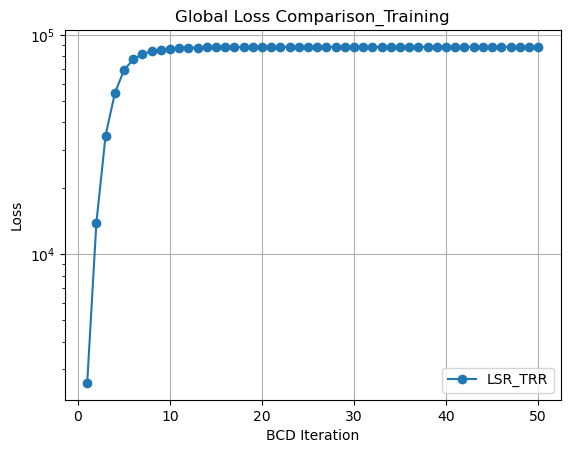

Final Objective Function Value CLOSED: [88245.14754026]


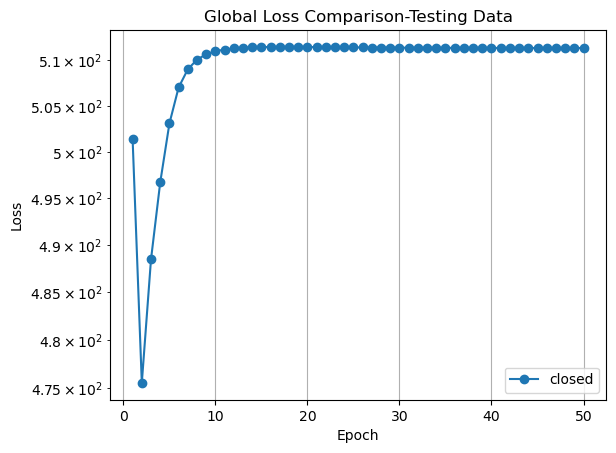

Final Objective Function Value CLOSED: 511.3768004428089


In [21]:

# Training 

training_objective_function_values = objective_function_values[:,0,2].reshape(-1,1)

plt.figure()
# Plotting closed form solver
plt.plot(range(1, len(training_objective_function_values) + 1), training_objective_function_values, label='LSR_TRR',marker = 'o')

# Setting the title and labels
plt.title('Global Loss Comparison_Training')
plt.yscale('log')
plt.xlabel('BCD Iteration')
plt.ylabel('Loss')
plt.yscale('log')
plt.grid(True)
# Adding a legend to distinguish the two plots
plt.legend()
# Display the plot
plt.show()

print('Final Objective Function Value CLOSED:',training_objective_function_values[-1])


# Testing 
def objective_function_tensor_sep(y: np.ndarray, X: np.ndarray, iterate_level_values, alpha,max_iteration,b = None):
    
    from optimization import inner_product
    
    function_value = []
    
    for iter in range(max_iteration):
        
        B11 = iterate_level_values[0][0][iter]
        B12 = iterate_level_values[0][1][iter]
        B21 = iterate_level_values[1][0][iter]
        B22 = iterate_level_values[1][1][iter]
        G = iterate_level_values[0][-1][iter] 
        
        full_lsr_tensor = np.zeros(shape = X[0].shape)
        
        #Calculate Expanded Tensor
        for s in range(len(iterate_level_values)-1):
            expanded_tucker_term = iterate_level_values[s][0][iter] @ G @ iterate_level_values[s][1][iter].T
            full_lsr_tensor += expanded_tucker_term
        
        B = full_lsr_tensor.flatten() 

        I = inner_product(X, B).flatten()
        y = y.flatten()
        B = B.flatten()
        
        regularizer = 0
        
        #developing the separable regularizing term
        
        # Calculate the Frobenius norm of each matrix
        
        norm_B11 = np.linalg.norm(B11, 'fro')
        norm_B12 = np.linalg.norm(B12, 'fro')
        #norm_B21 = np.linalg.norm(B21, 'fro')
        #norm_B22 = np.linalg.norm(B22, 'fro')
        norm_G = np.linalg.norm(G, 'fro')
        

        # Calculate the sum of Frobenius norms
        regularizer = norm_B11 + norm_B12 + norm_G #+ norm_B21 + norm_B22
        if b is not None:
            b = b.flatten()
            function = (np.linalg.norm(y - I -b) ** 2) + (alpha * regularizer)
        else:
            function = (np.linalg.norm(y - I) ** 2) + (alpha * regularizer)
        
        function_value.append(function)
    
    return function_value


#closed_form
closed_test_loss = objective_function_tensor_sep(Y_test,X_test,iterate_level_values,lambda1,50,b = None)

plt.figure()

# Plotting SGD
plt.plot(range(1, len(closed_test_loss) + 1),closed_test_loss, label='closed',marker = 'o')

# Setting the title and labels
plt.title('Global Loss Comparison-Testing Data')
plt.yscale('log')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.grid(True)

# Adding a legend to distinguish the two plots
plt.legend()

# Display the plot
plt.show()

print('Final Objective Function Value CLOSED:',closed_test_loss[-1])



#### Gradient Plots

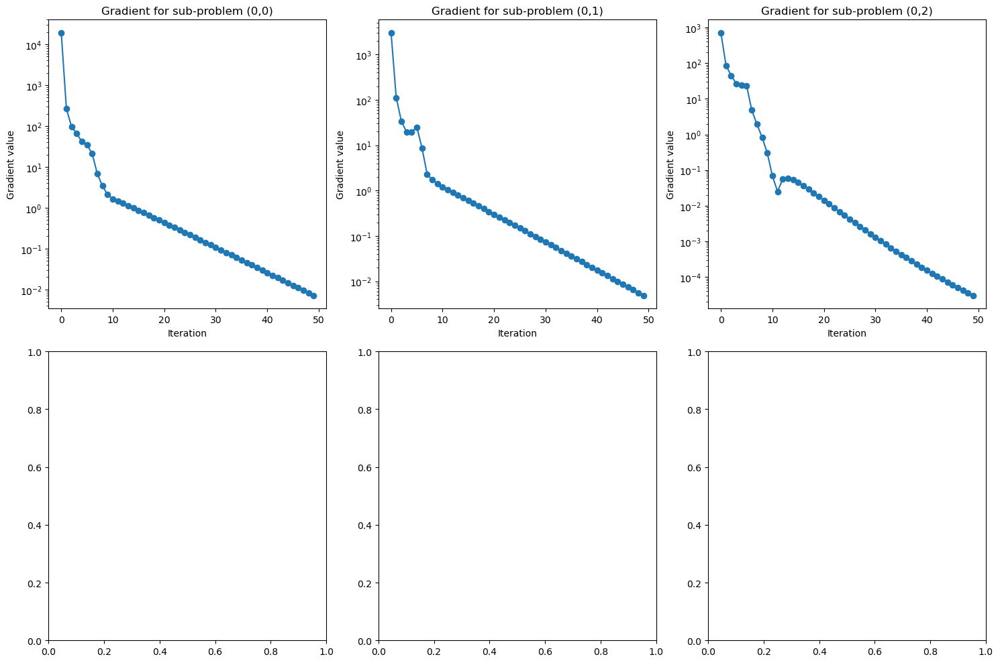

In [16]:
# Create subplots
fig, axs = plt.subplots(2, 3, figsize=(15, 10))

# Determine the number of rows and columns for subplots
num_rows = len(all_diff_sep)
num_cols = len(all_diff_sep[0]) if num_rows > 0 else 0

# Iterate over each subplot
for i in range(1):
    for j in range(num_cols):
        axs[i, j].plot(gradient_values[:, i, j],marker = 'o')
        axs[i, j].set_title(f'Gradient for sub-problem ({i},{j})')
        axs[i, j].set_xlabel('Iteration')
        axs[i, j].set_ylabel('Gradient value')
        axs[i,j].set_yscale('log')

# Adjust layout
plt.tight_layout()

# Show plot
plt.show()

### Iterate Difference 

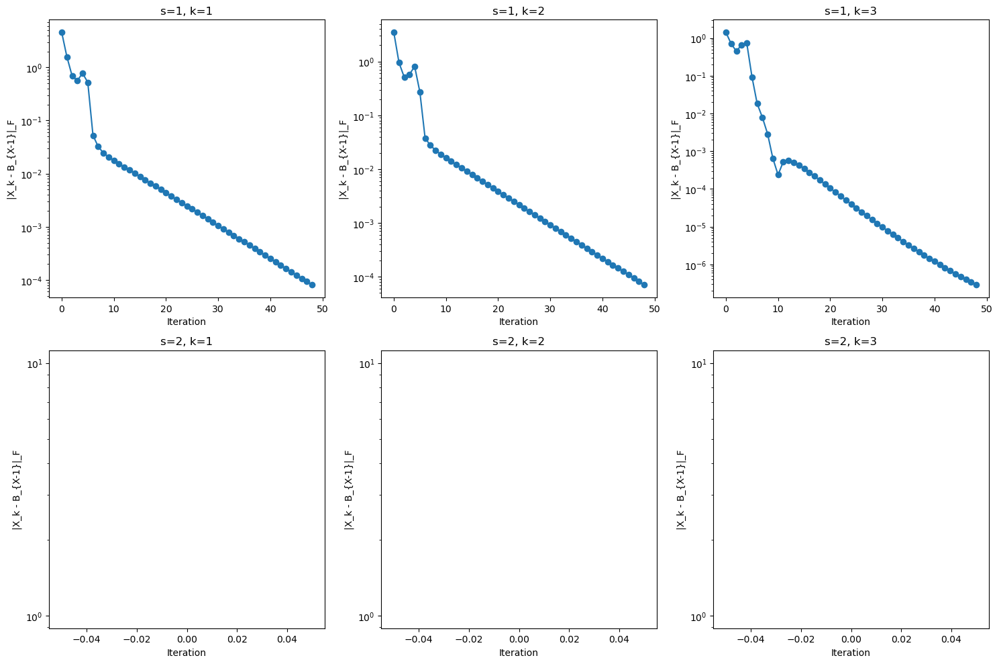

In [12]:
# factor matrix

def iterate_diff(iterate_level_values,s,k,max_iter):
    B = iterate_level_values[s][k]
    iter_diff = []
    for i in range(1,max_iter):
        diff = B[i] - B[i-1]
        norm_diff = np.linalg.norm(diff,'fro')
        iter_diff.append(norm_diff)
    return iter_diff

import numpy as np

all_diff_sep = []
for s in range(len(iterate_level_values)):
    all_diff_fac = []
    for k in range(len(iterate_level_values[s])):
        if len(iterate_level_values[s][k][0]) == 0:  # Check if the array is empty
            difference = []
            all_diff_fac.append(difference)
        else:
            difference = iterate_diff(iterate_level_values, s, k, 50) 
            all_diff_fac.append(difference)
    all_diff_sep.append(all_diff_fac)

# Determine the number of rows and columns for subplots
num_rows = len(all_diff_sep)
num_cols = len(all_diff_sep[0]) if num_rows > 0 else 0


# Create subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))

# Iterate through all_diff_sep to plot the differences
for s in range(num_rows):
    for k in range(num_cols):
        ax = axes[s, k] if num_rows > 1 else axes[k]
        ax.plot(all_diff_sep[s][k],marker = 'o')
        ax.set_title(f's={s+1}, k={k+1}')
        ax.set_xlabel('Iteration')
        ax.set_ylabel('|X_k - B_{X-1}|_F')
        ax.set_yscale('log')

# Adjust layout for better readability
plt.tight_layout()
plt.show()




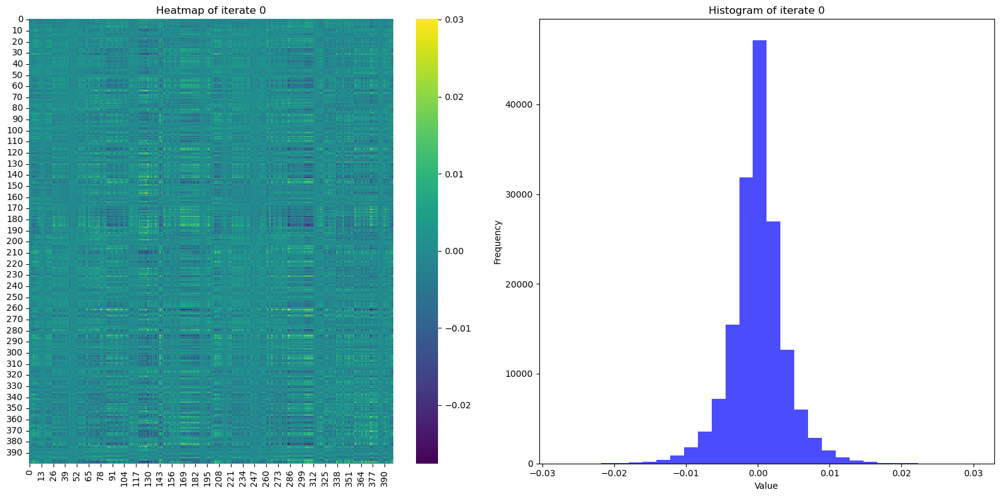

Energy of iterate 0: 1.7169382818502883


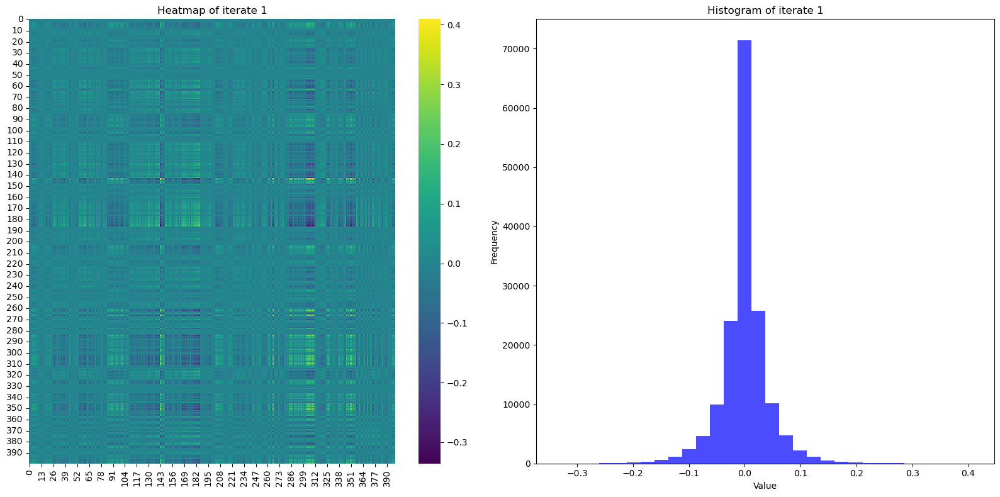

Energy of iterate 1: 17.51739634235878


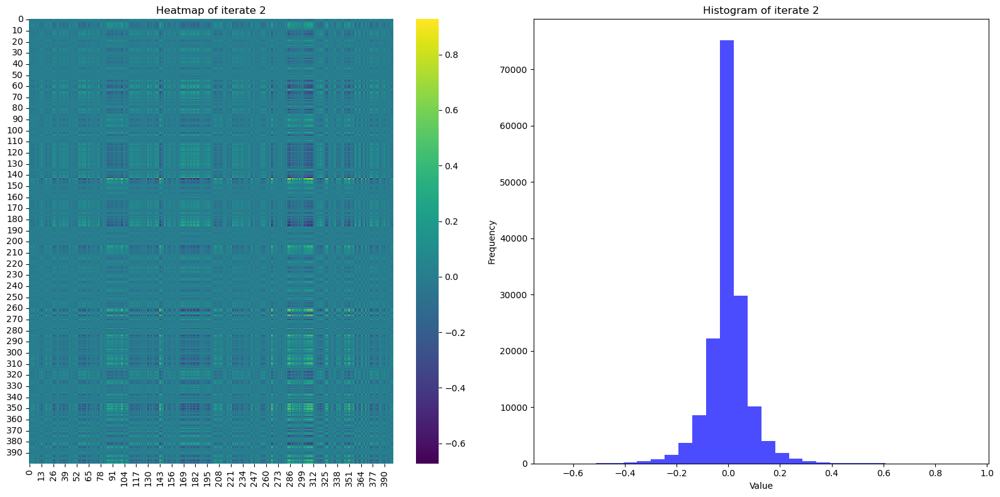

Energy of iterate 2: 25.400106609081156


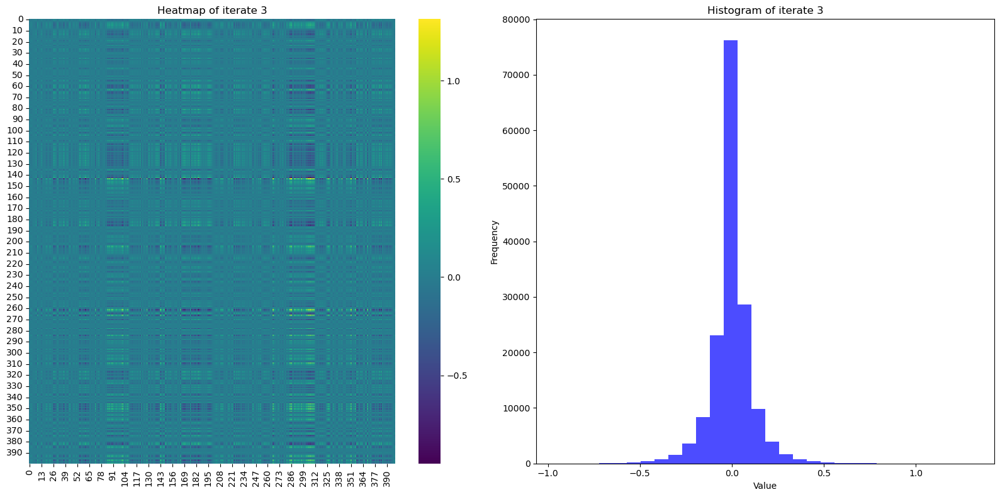

Energy of iterate 3: 19.146978010881085


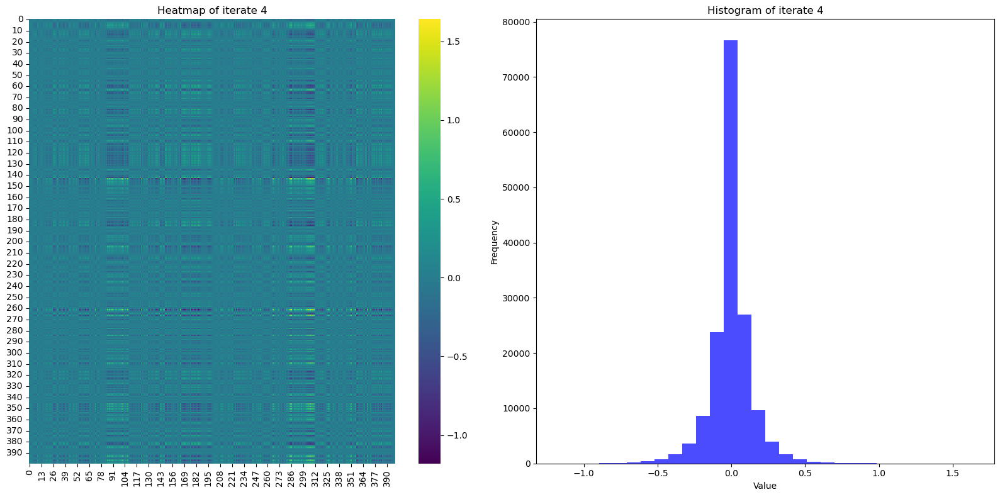

Energy of iterate 4: 10.817527801035192


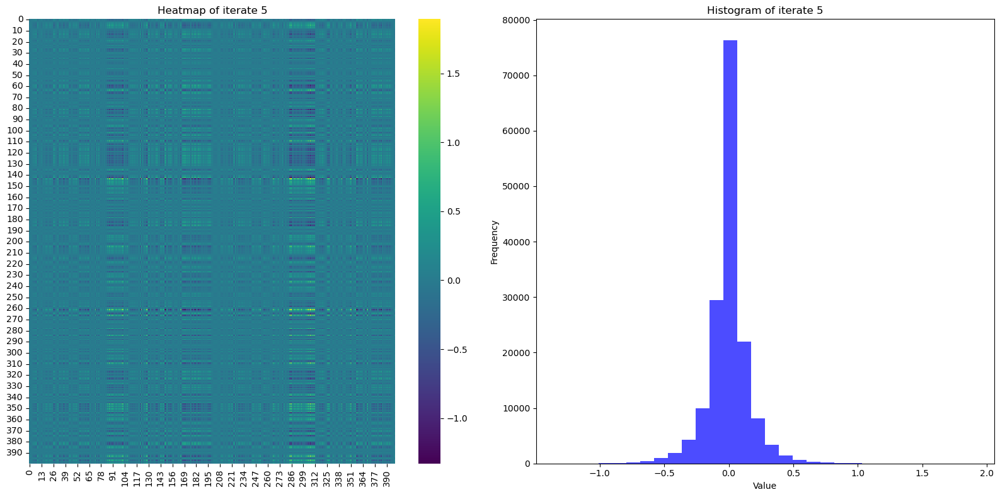

Energy of iterate 5: 6.576315884007434


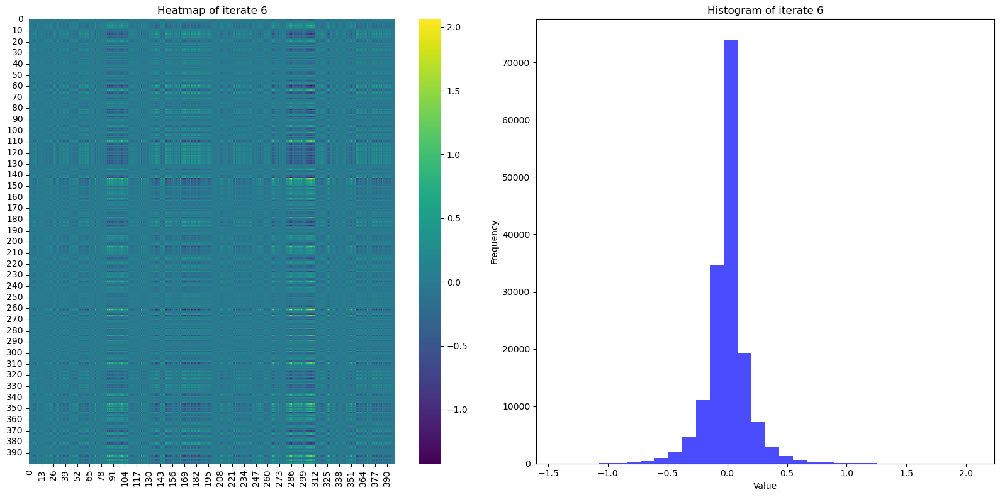

Energy of iterate 6: 4.437650457273911


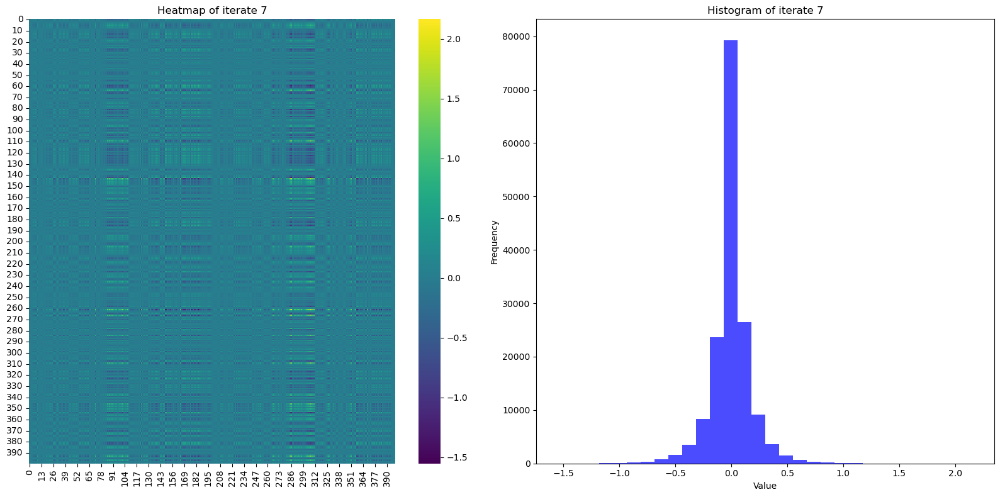

Energy of iterate 7: 3.2180119850786384


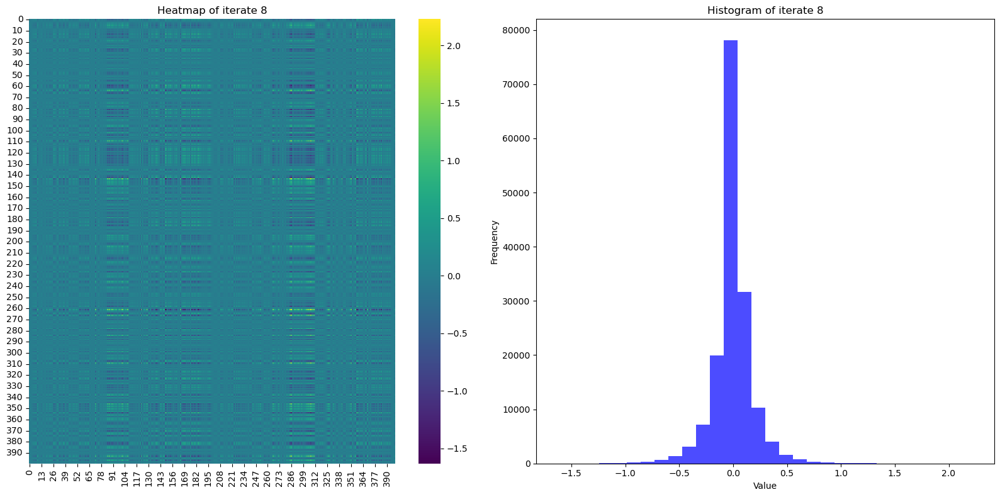

Energy of iterate 8: 2.478694098436925


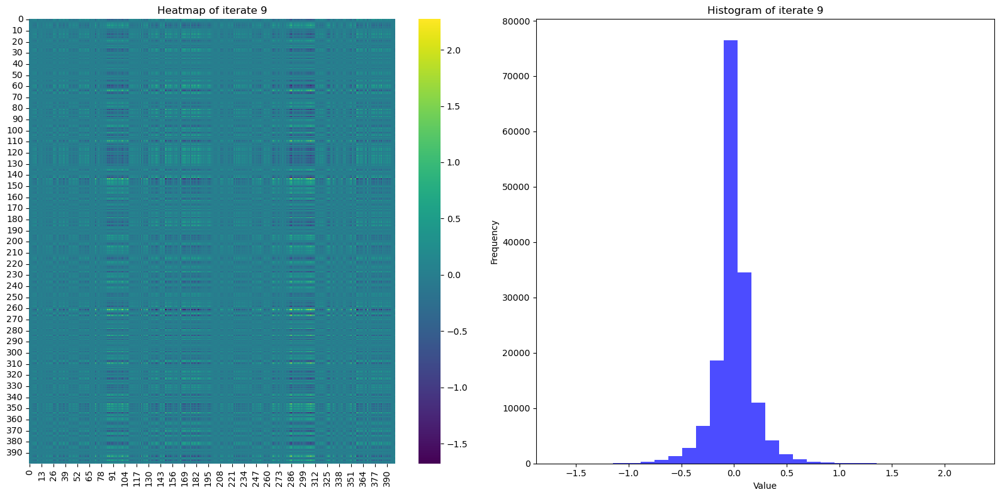

Energy of iterate 9: 2.0157076861051313


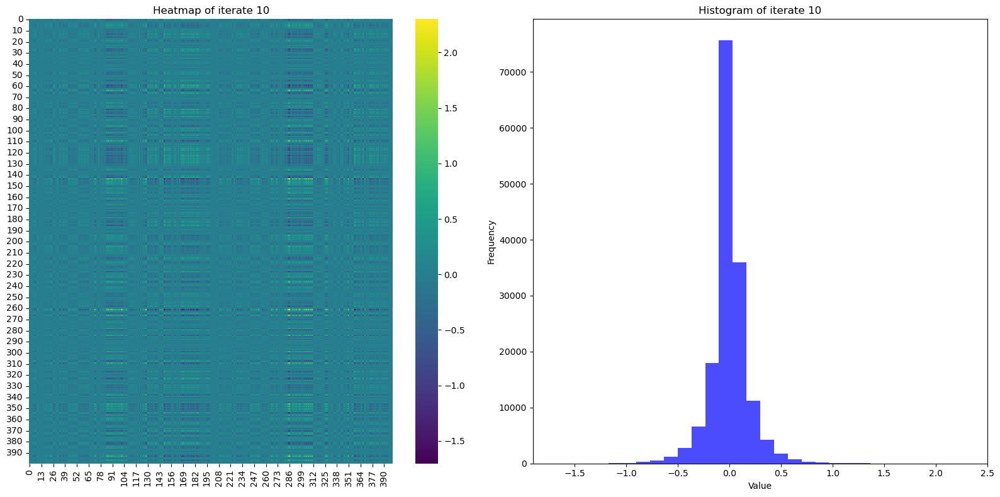

Energy of iterate 10: 1.7187881187182055


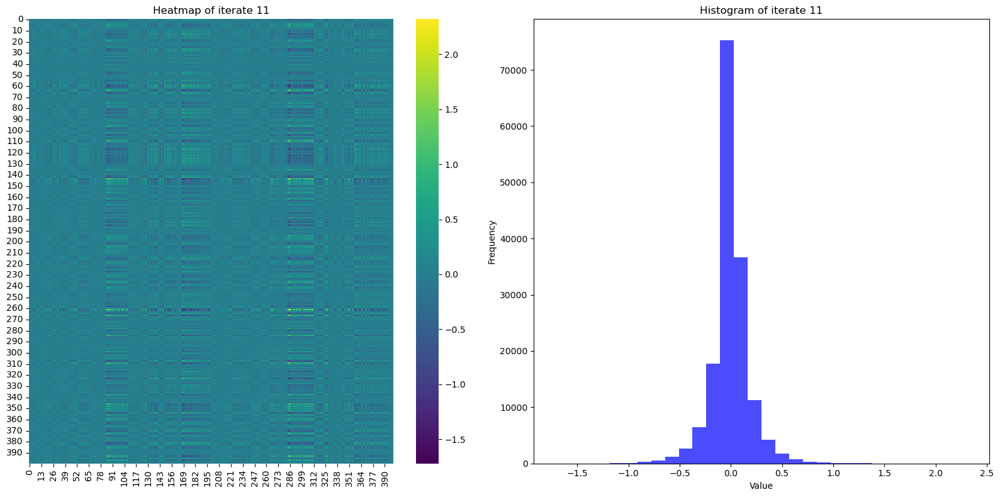

Energy of iterate 11: 1.5245724611961062


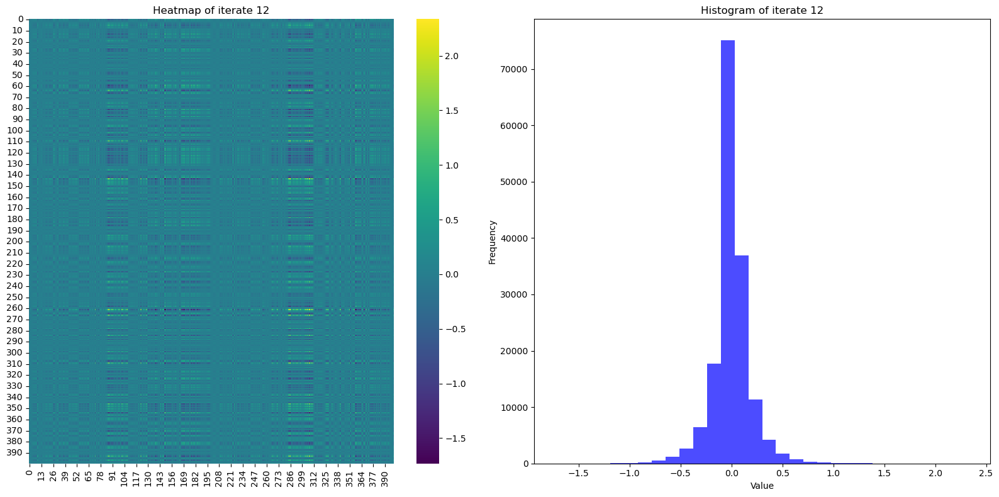

Energy of iterate 12: 1.395429958978181


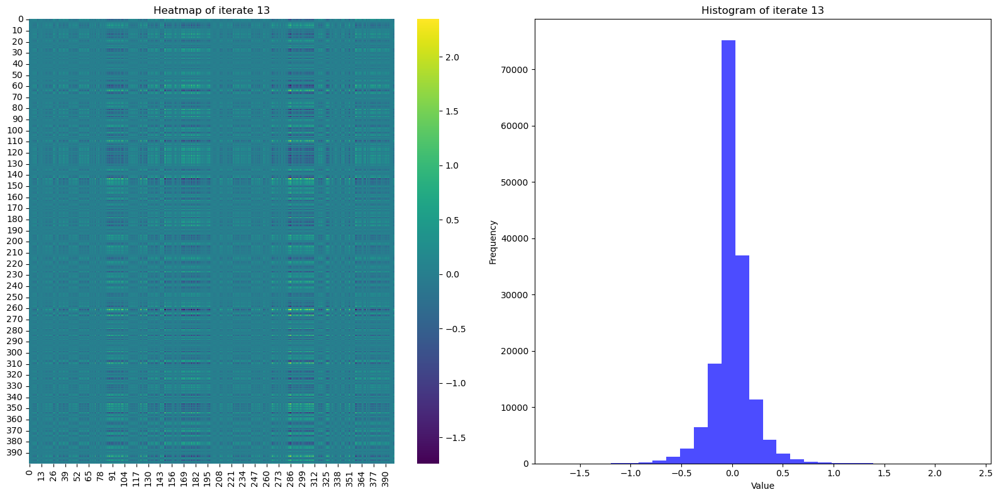

Energy of iterate 13: 1.3084247223740821


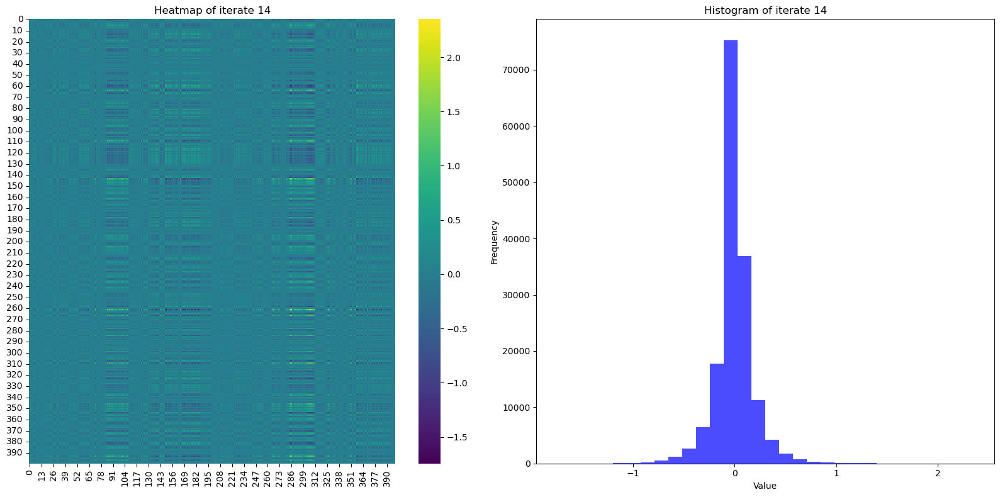

Energy of iterate 14: 1.2492426823881557


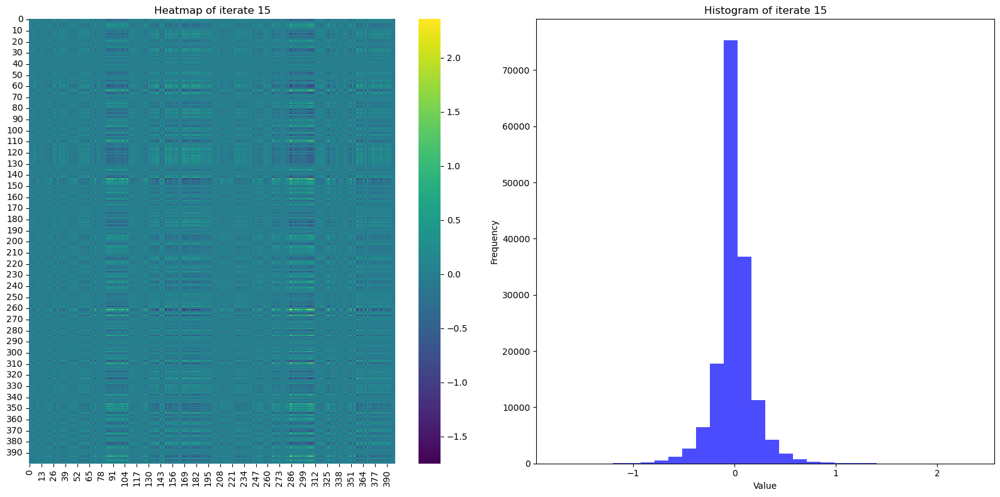

Energy of iterate 15: 1.2087493472658037


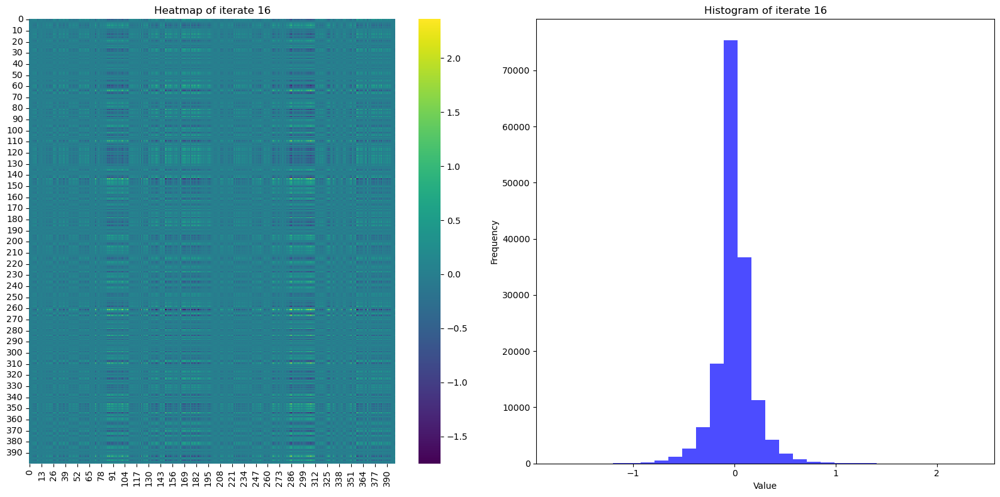

Energy of iterate 16: 1.1809920114630081


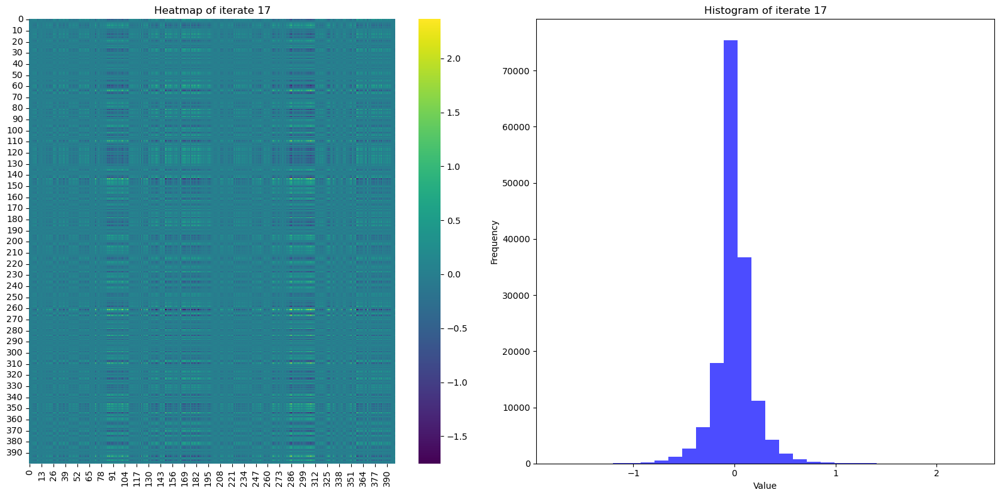

Energy of iterate 17: 1.162015193003583


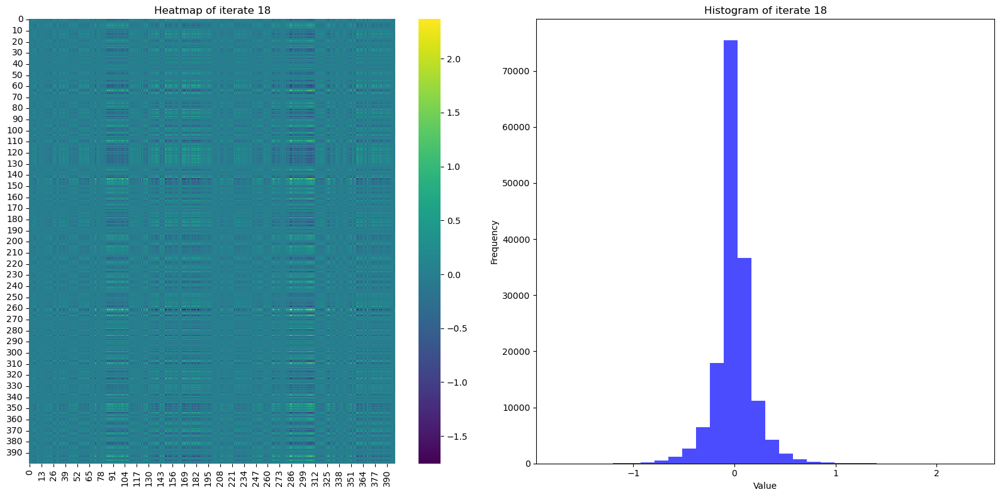

Energy of iterate 18: 1.149143846943089


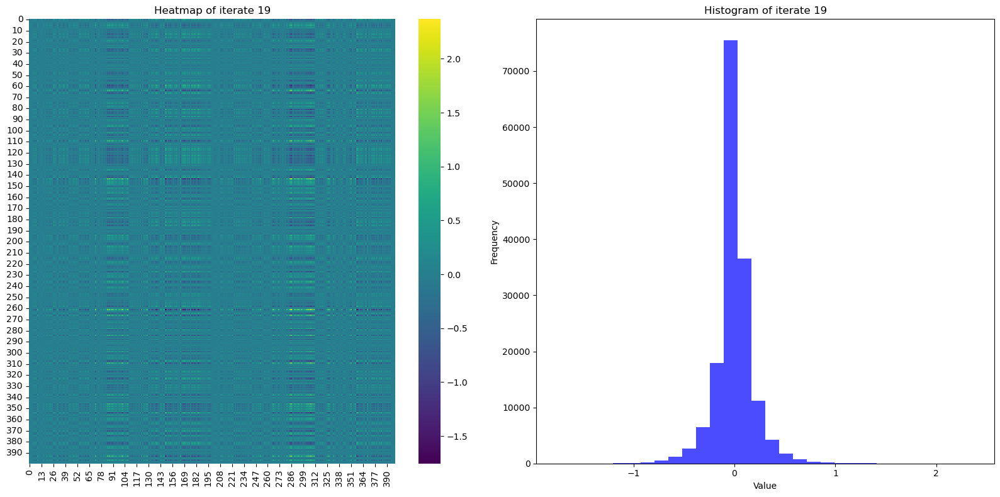

Energy of iterate 19: 1.1405408678087903


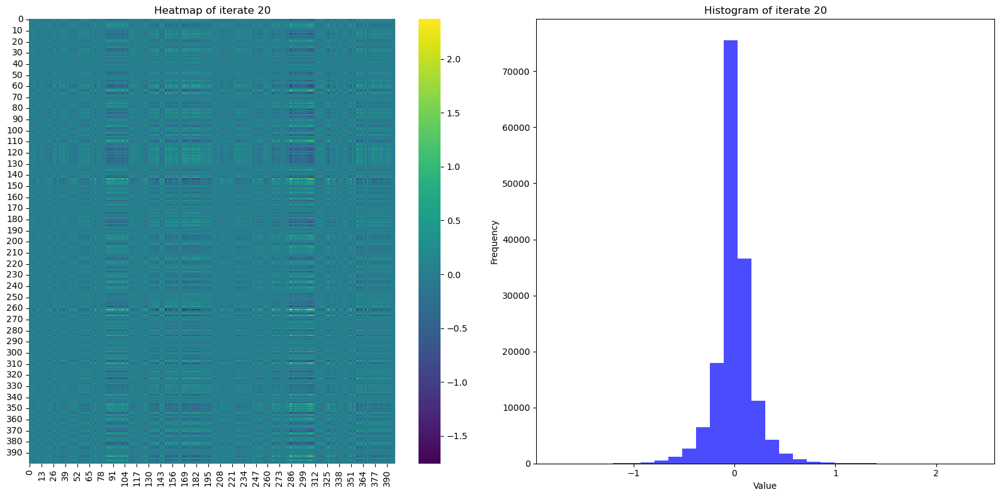

Energy of iterate 20: 1.1349283455368742


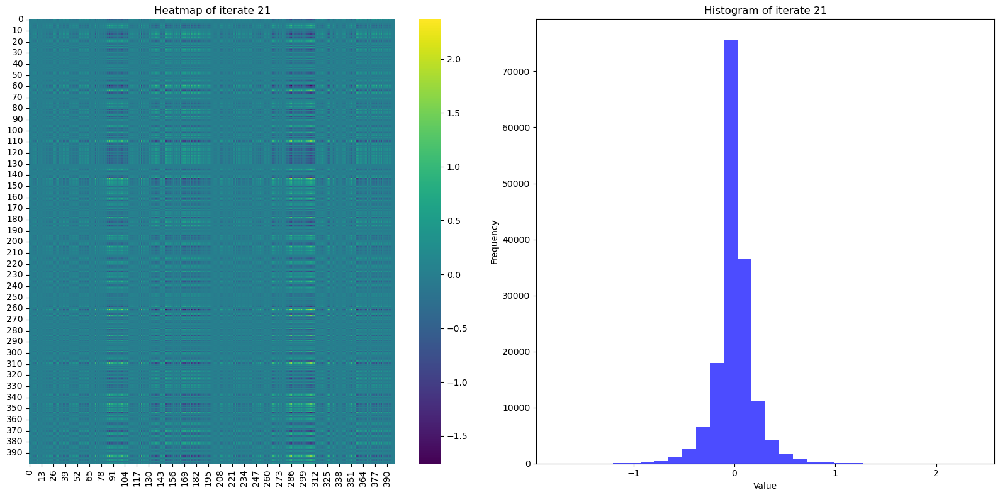

Energy of iterate 21: 1.1314083414930791


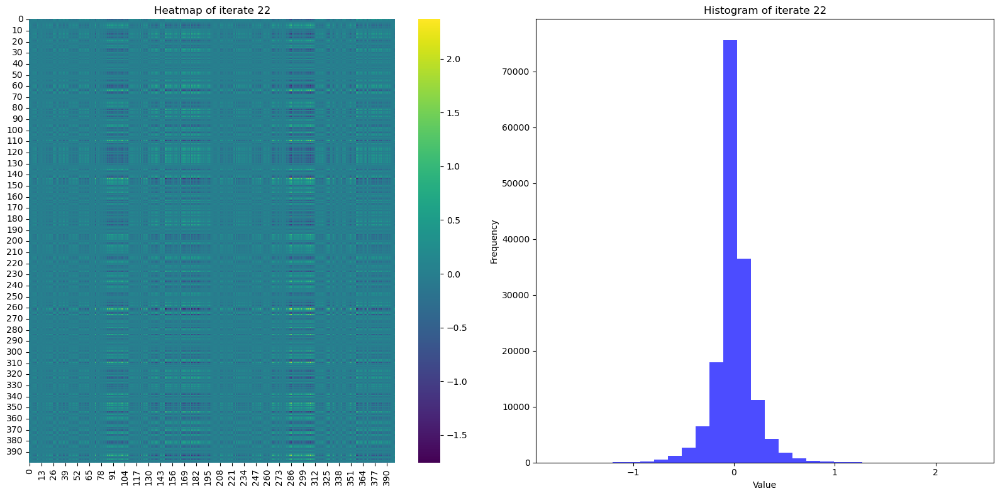

Energy of iterate 22: 1.1293452735120966


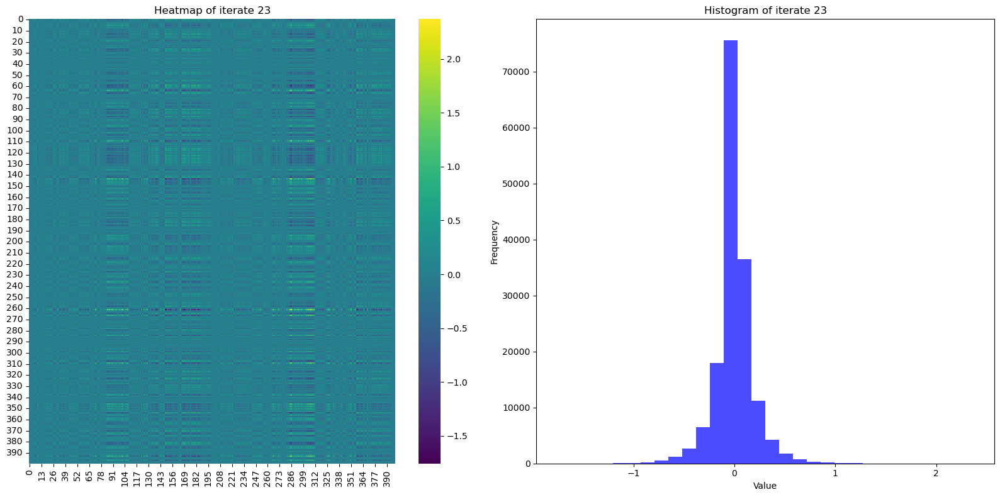

Energy of iterate 23: 1.128287189104587


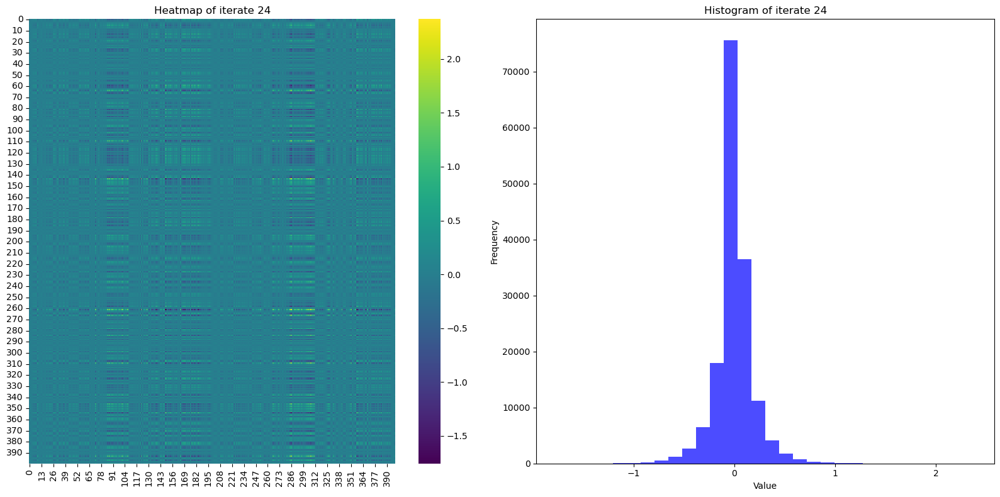

Energy of iterate 24: 1.127912087835531


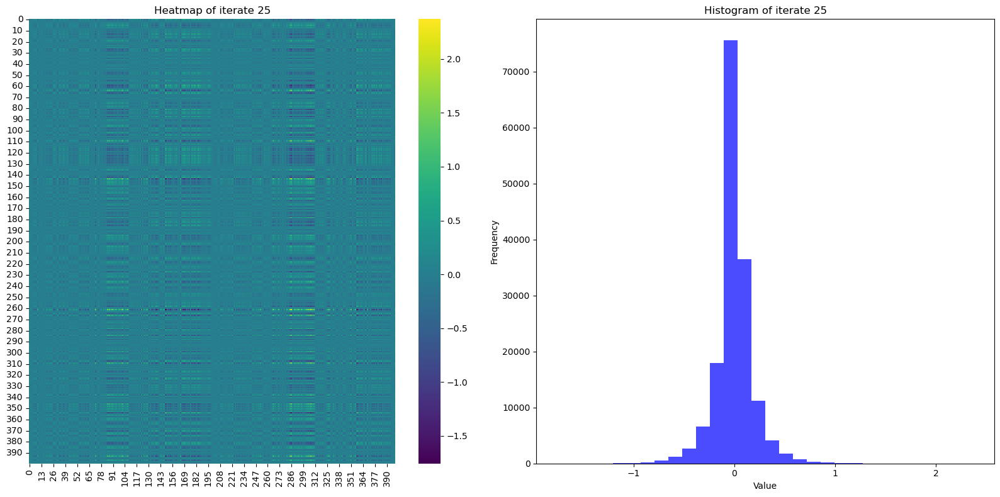

Energy of iterate 25: 1.1279907138901695


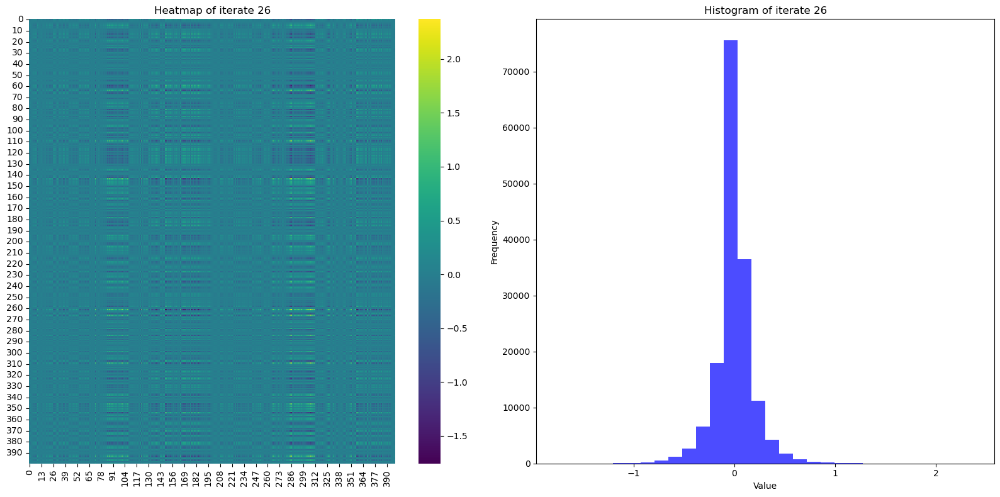

Energy of iterate 26: 1.1283603976847


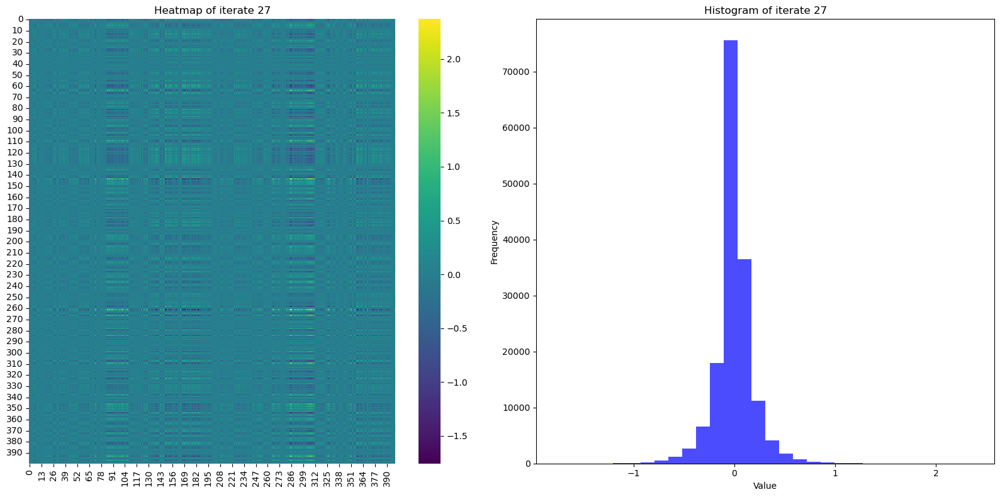

Energy of iterate 27: 1.12890645043563


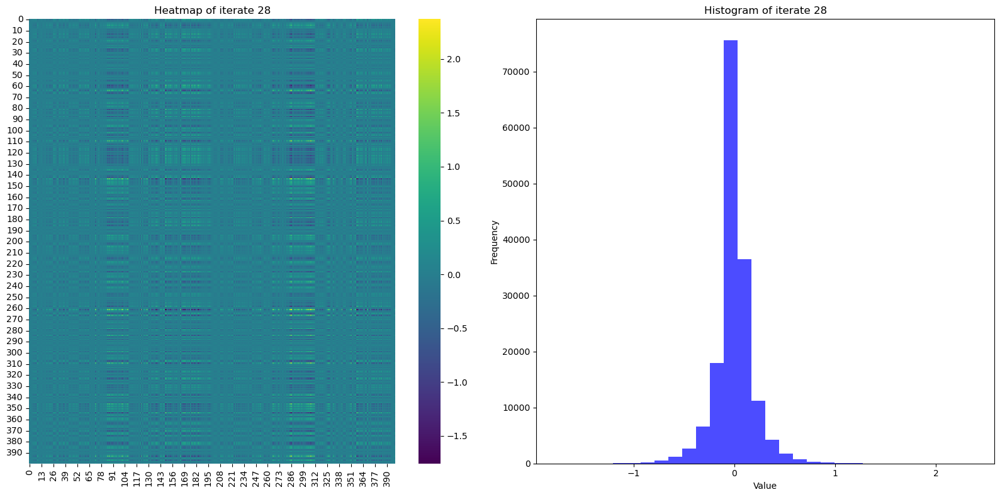

Energy of iterate 28: 1.1295488096454933


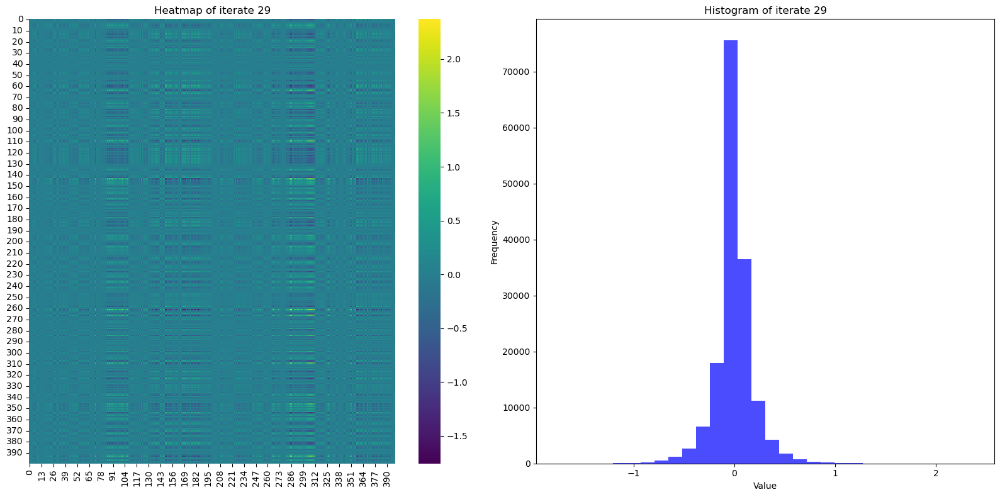

Energy of iterate 29: 1.130232388469466


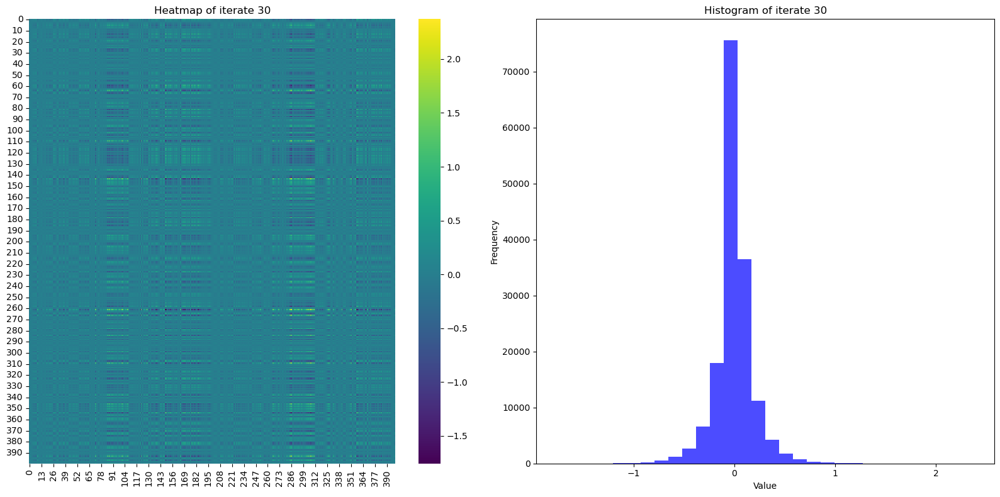

Energy of iterate 30: 1.130920069255206


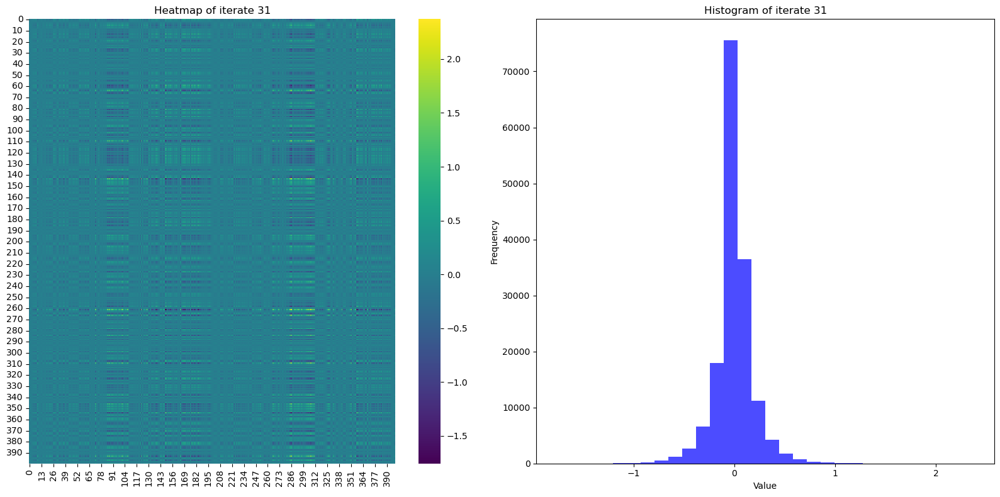

Energy of iterate 31: 1.1315876028139433


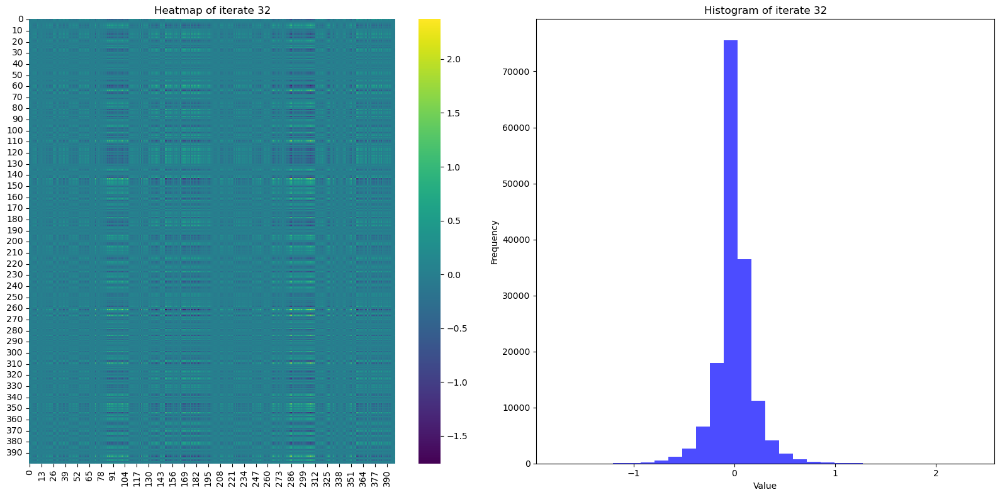

Energy of iterate 32: 1.1322198911985657


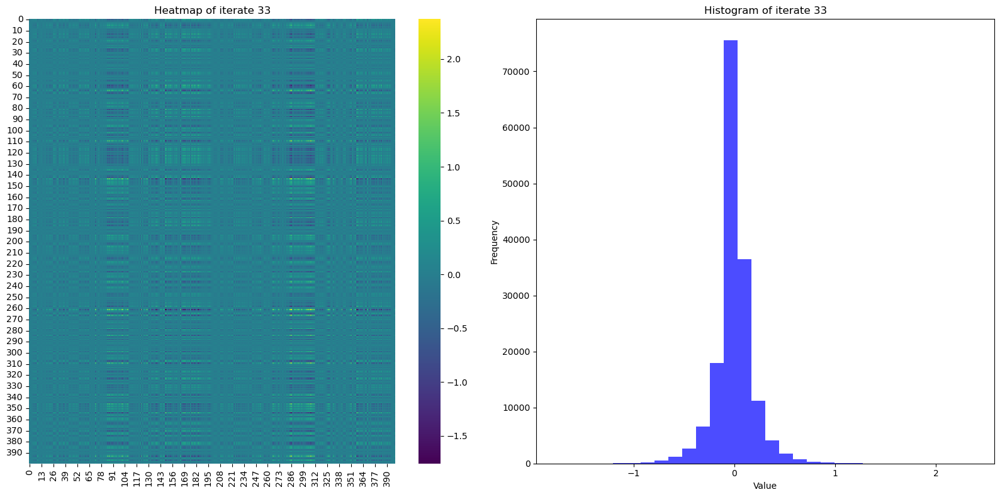

Energy of iterate 33: 1.1328082801323303


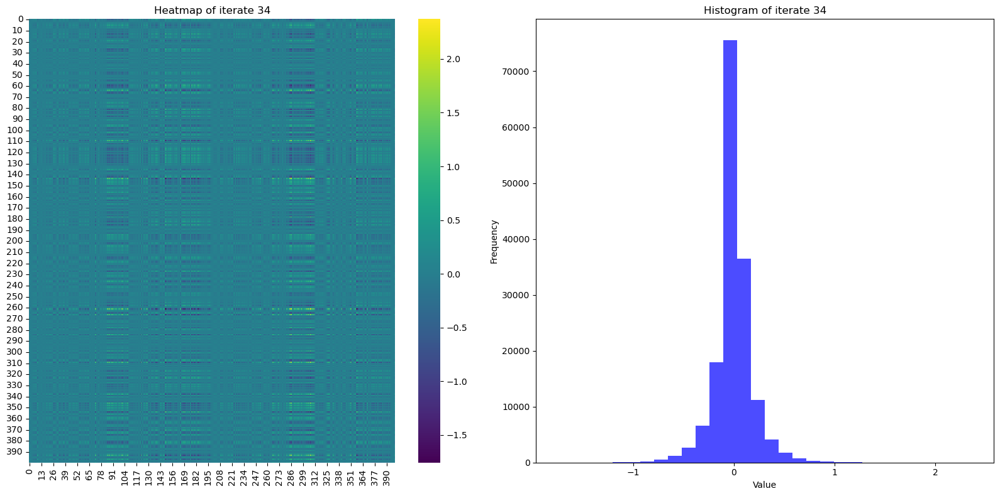

Energy of iterate 34: 1.1333485908140568


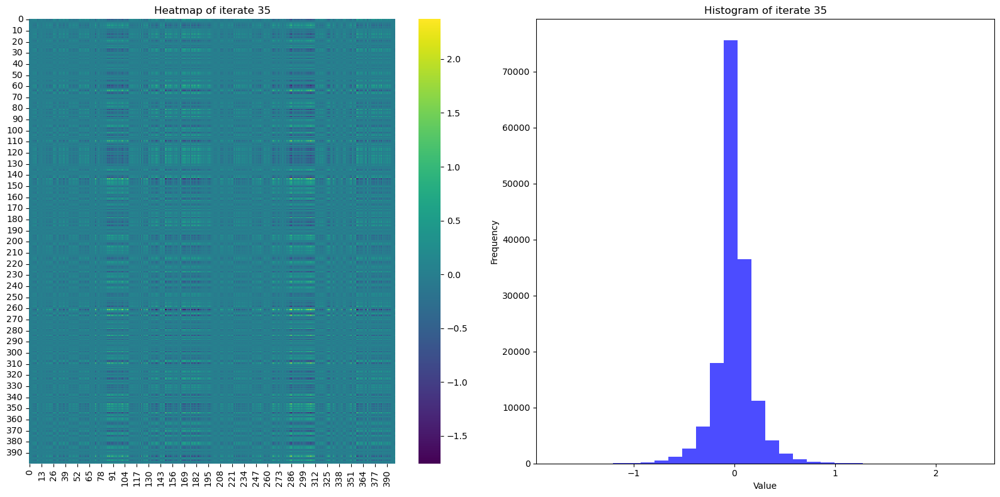

Energy of iterate 35: 1.1338396942352962


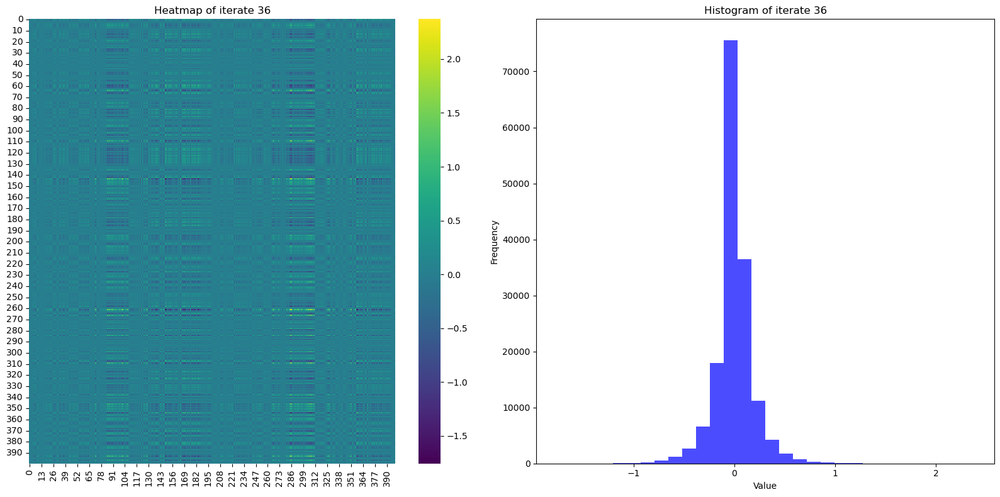

Energy of iterate 36: 1.1342824838122292


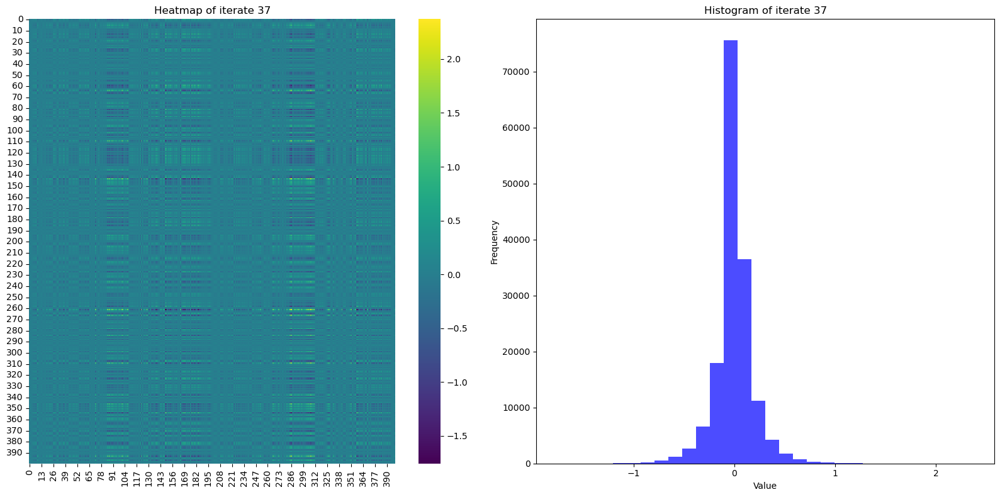

Energy of iterate 37: 1.1346791402985192


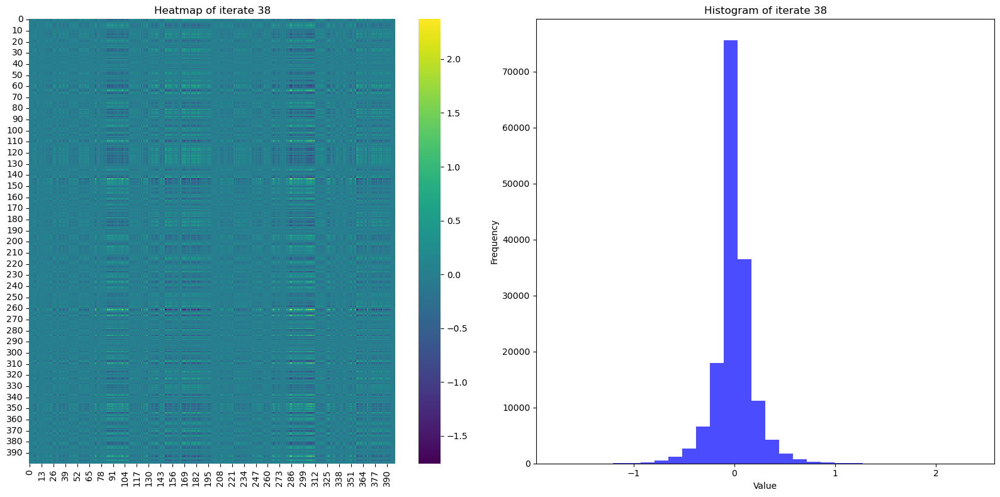

Energy of iterate 38: 1.1350326108159978


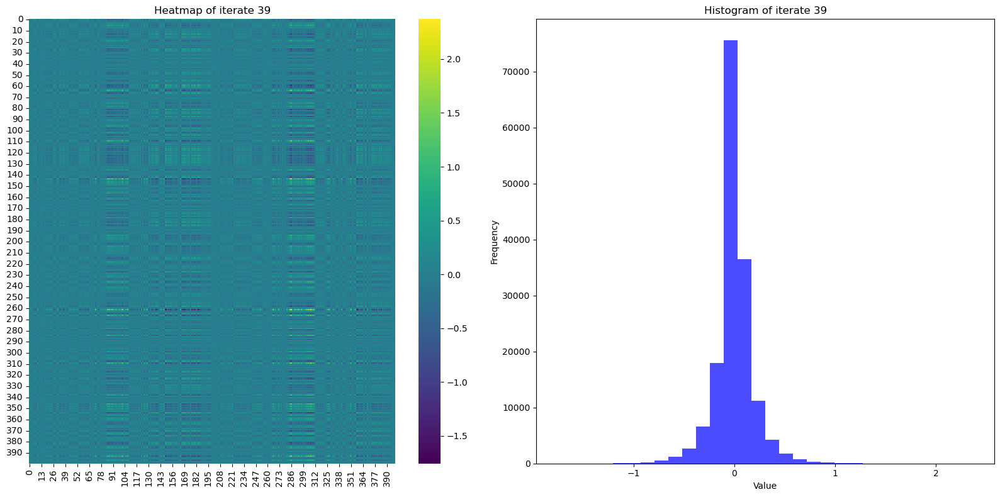

Energy of iterate 39: 1.1353462443060687


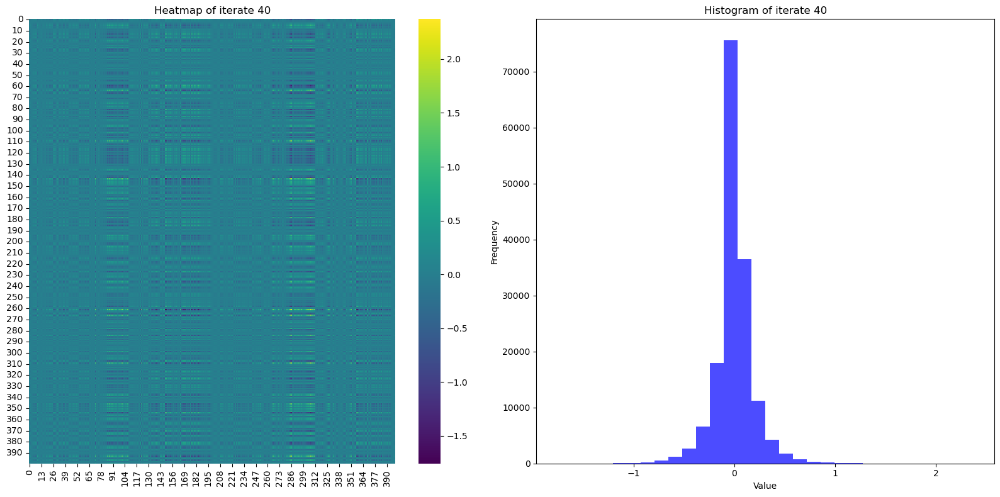

Energy of iterate 40: 1.1356235408000512


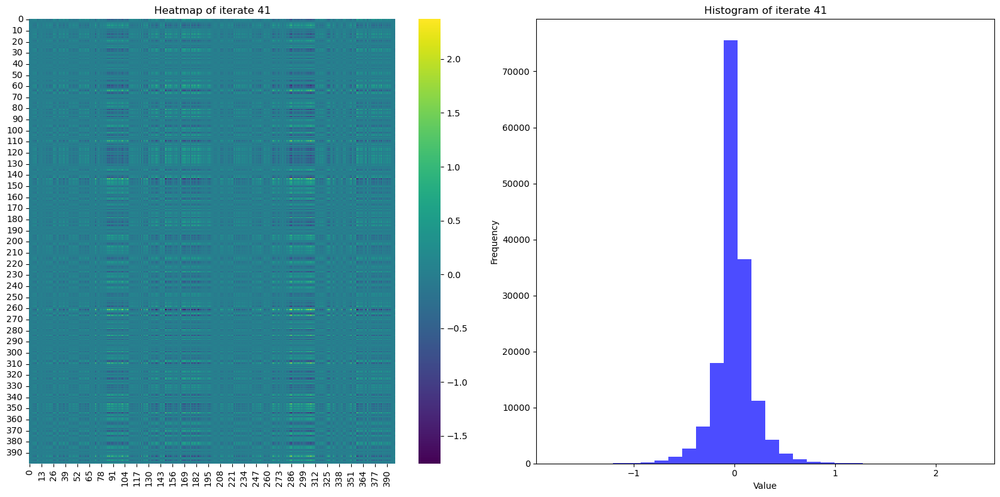

Energy of iterate 41: 1.135867983072129


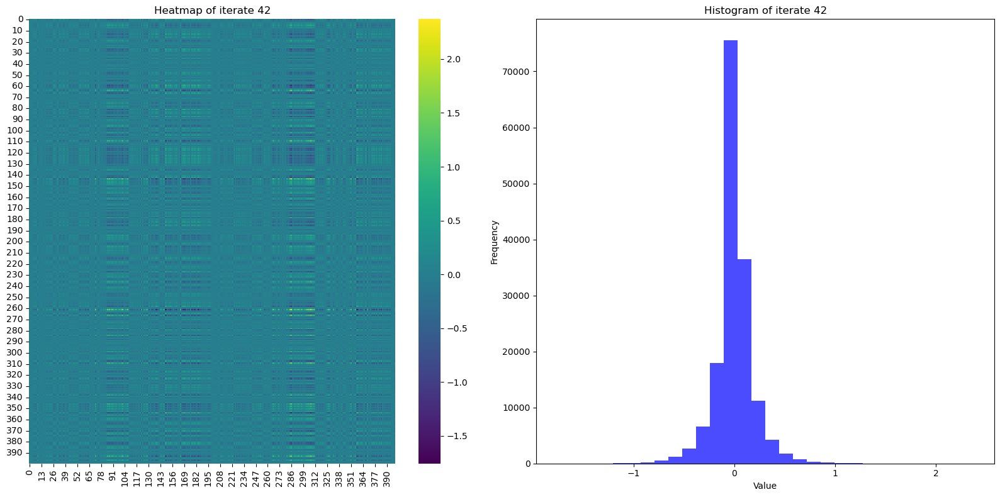

Energy of iterate 42: 1.136082927508382


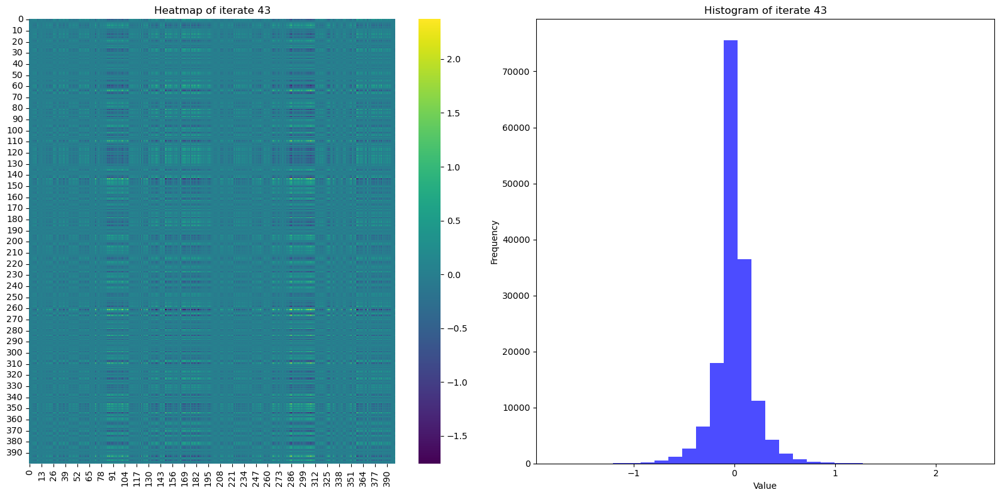

Energy of iterate 43: 1.136271537160594


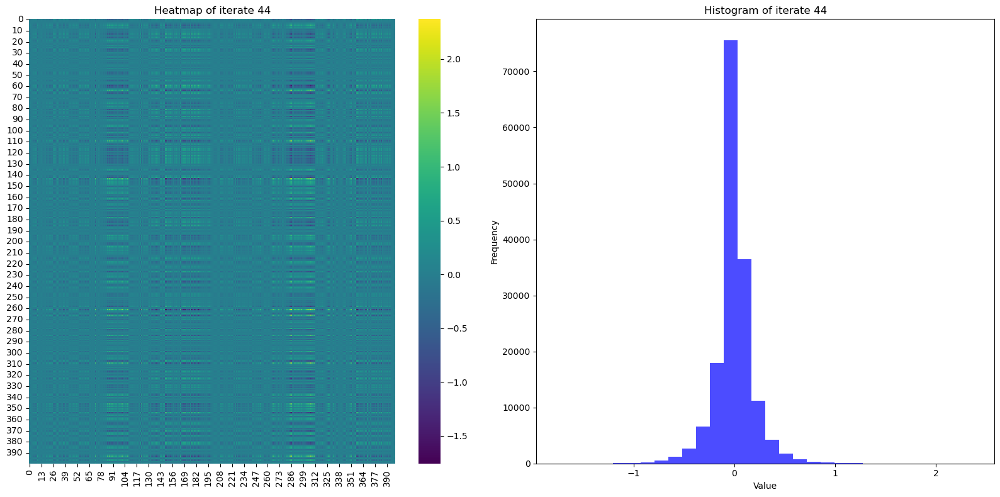

Energy of iterate 44: 1.1364367445001926


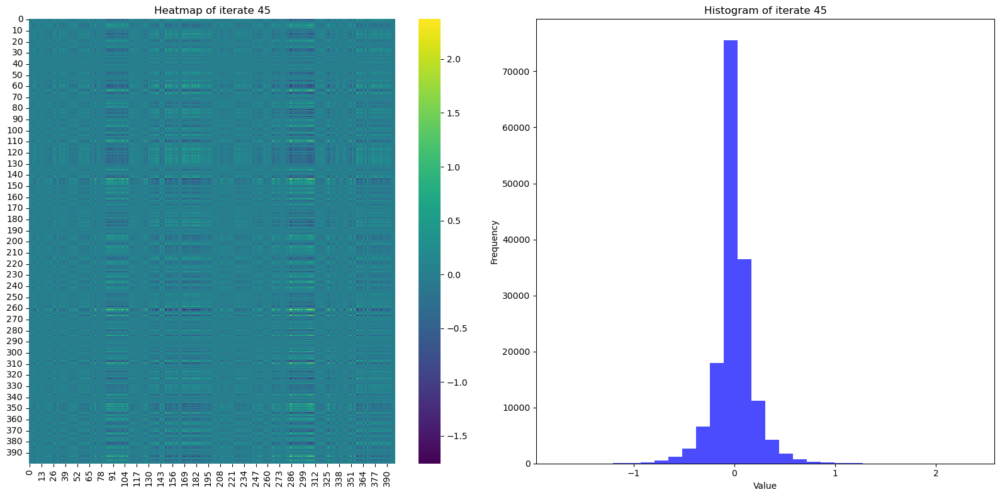

Energy of iterate 45: 1.1365812347601905


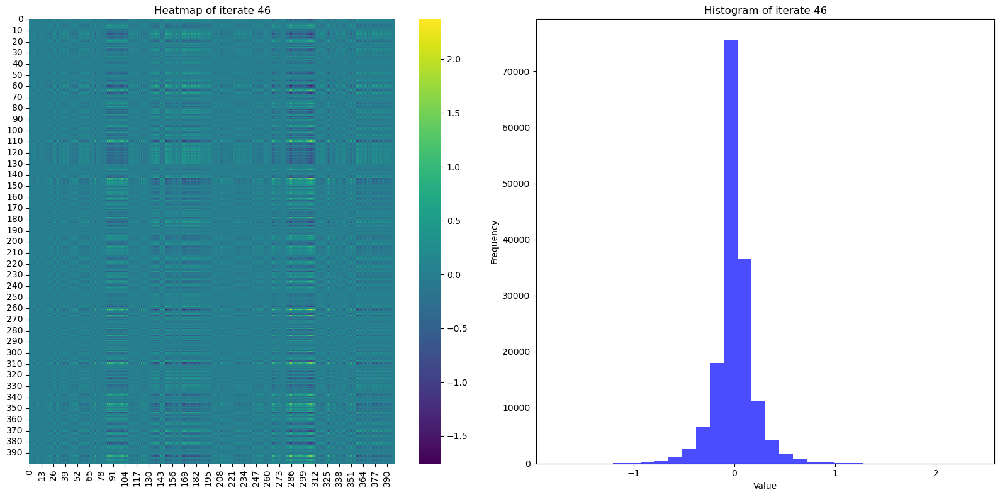

Energy of iterate 46: 1.1367074432462554


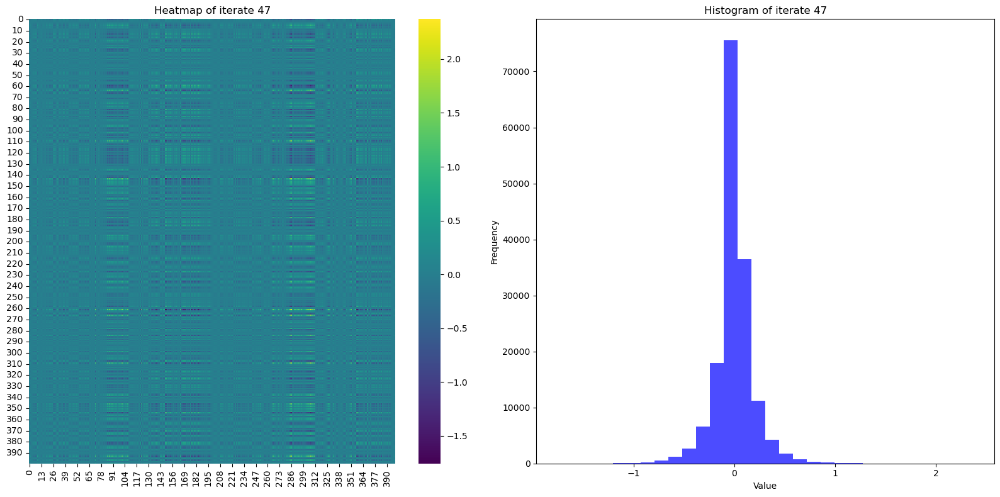

Energy of iterate 47: 1.1368175618436371


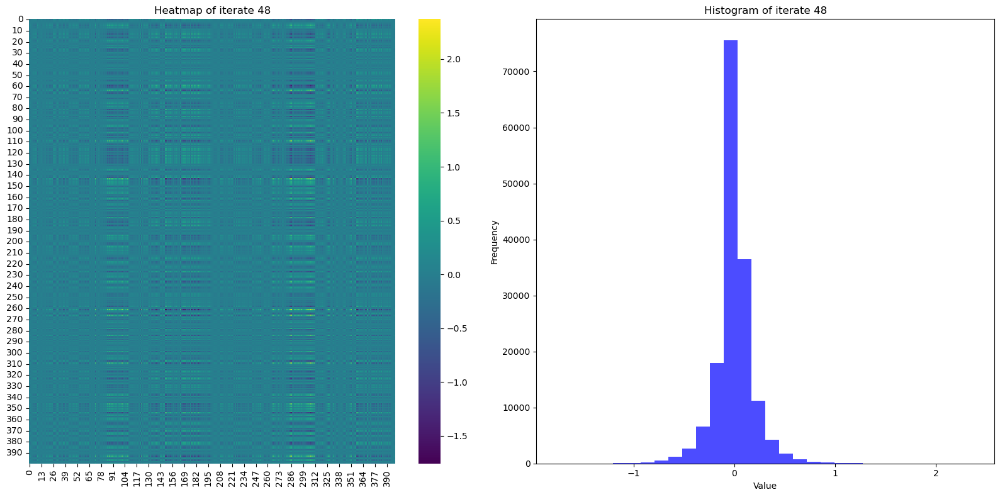

Energy of iterate 48: 1.1369135513026445


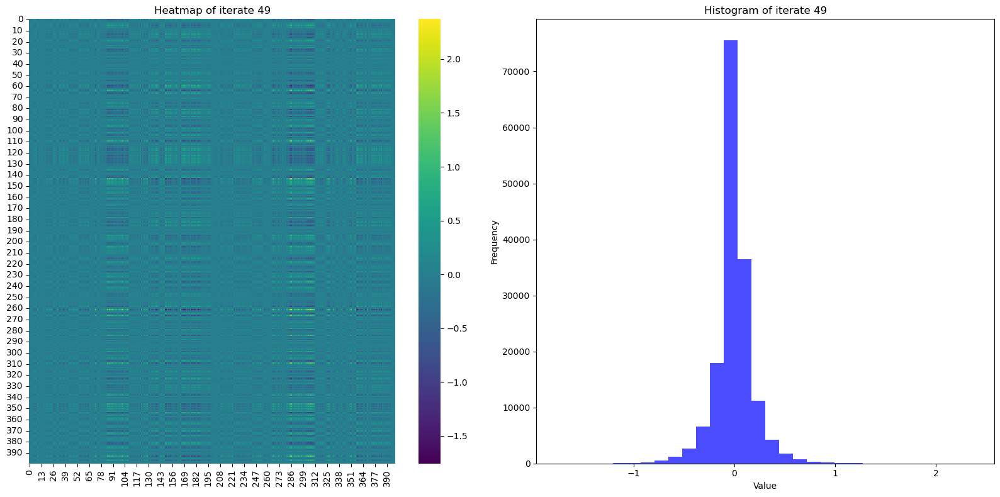

Energy of iterate 49: 1.1369971568867943


In [8]:
## Looking at the factor matrices
separation_rank = 2
tucker_ranks = [4,4]
max_iter = 50

for i in range(max_iter):
    # Get the matrix
    iterate = iterate_level_values[separation_rank-1][len(tucker_ranks)][i]
    
    # Create a figure with 2 subplots: one for the heatmap and one for the histogram
    fig, ax = plt.subplots(1, 2, figsize=(16, 8))
    
    # Plot the heatmap on the first subplot
    sns.heatmap(iterate, cmap='viridis', cbar=True, ax=ax[0])
    ax[0].set_title(f'Heatmap of iterate {i}')
    
    # Plot the histogram on the second subplot
    ax[1].hist(iterate.flatten(), bins=30, color='blue', alpha=0.7)
    ax[1].set_title(f'Histogram of iterate {i}')
    ax[1].set_xlabel('Value')
    ax[1].set_ylabel('Frequency')
    
    # Show the plot
    plt.tight_layout()
    plt.show()
    
    # Calculate the energy of the matrix
    eigen_values = np.linalg.eigvals(iterate)
    energy = np.sum(np.abs(eigen_values)) 
    
    print(f'Energy of iterate {i}:', energy)

    